In [1]:
%load_ext autoreload
%autoreload 2
import jax
import jax.numpy as jnp
import jax.random as jrandom
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import clear_output
%matplotlib widget
from tqdm.notebook import tqdm
import functools as ft
import optax
import treex as tx
import sdf_jax
from sdf_jax.discretize import discretize3d
from sdf_jax.util import plot3d, plot2d

In [8]:
import trimesh
import os

def show_points(positions, colors=None):
    if colors is None:
        colors = np.tile(np.array([0, 0, 0, 1]), (len(positions), 1))
    p = trimesh.PointCloud(positions, colors=colors)
    return p.scene().show()

def load_sdf_data(path):
    data = jax.tree_map(jnp.array, dict(jnp.load(path)))
    data["position"] -= data["position"].min(axis=0)
    scale_factor = data["position"].max()
    data["position"] /= scale_factor
    data["distance"] /= scale_factor
    data["distance"] = data["distance"].reshape(-1)
    return data

data = load_sdf_data("../../samples/rand/Fish.npz")
jax.tree_map(jnp.shape, dict(data))

{'distance': (1000000,), 'gradient': (1000000, 3), 'position': (1000000, 3)}

In [19]:
show_points(data["position"])

In [7]:
show_points(data["position"][jnp.abs(data["distance"]) < 1e-3])

In [3]:
xs = data["position"]

## SDF based on Hash Encoding

In [4]:
from sdf_jax import hash_encoding

class HashEmbedding(tx.Module):
    theta: jnp.ndarray = tx.Parameter.node()

    def __init__(
        self, 
        levels: int=16, 
        hashmap_size_log2: int=14, 
        features_per_entry: int=2,
        nmin: int=16,
        nmax: int=512,
    ):
        self.levels = levels
        self.hashmap_size_log2 = hashmap_size_log2
        self.features_per_entry = features_per_entry
        self.nmin = nmin
        self.nmax = nmax

    def __call__(self, x):
        assert x.ndim == 1
        if self.initializing():
            hashmap_size = 1 << self.hashmap_size_log2
            key = tx.next_key()
            self.theta = jrandom.uniform(
                key, 
                (self.levels, hashmap_size, self.features_per_entry), 
                minval=-0.0001, 
                maxval=0.0001
            )
        
        y = hash_encoding.encode(x, self.theta, self.nmin, self.nmax)
        return y.reshape(-1)

emb = HashEmbedding().init(key=42, inputs=xs[0])
emb(xs[0]).shape

(32,)

In [5]:
from sdf_jax.util import dataloader

@ft.partial(jax.value_and_grad, has_aux=True)
def loss_fn(params, model, x, y):
    model = model.merge(params)
    preds = jax.vmap(model)(x)
    loss = jnp.mean(jnp.abs(preds - y) / (jnp.abs(y) + 0.01))
    return loss, model

@jax.jit
def train_step(model, x, y, optimizer):
    params = model.filter(tx.Parameter)
    (loss, model), grads = loss_fn(params, model, x, y)
    new_params = optimizer.update(grads, params)
    model = model.merge(new_params)
    return loss, model, optimizer

def print_callback(step, loss, model, optimizer):
    print(f"[{step}] loss: {loss:.4f}")

def fit(
    xs,
    ys,
    # module
    hidden=64,
    act=jax.nn.relu,
    emb_kwargs={"nmax": 32},
    # optimizer
    key=jrandom.PRNGKey(1234),
    lr=1e-4,
    steps=100,
    batch_size=128,
    # utils
    cb=print_callback,
    cb_every=10,
):
    key, model_key = jrandom.split(key, 2)
    model = tx.Sequential(
        HashEmbedding(**emb_kwargs),
        tx.Linear(hidden),
        act,
        tx.Linear(hidden),
        act,
        tx.Linear(1),
        lambda x: x[0]
    ).init(key=model_key, inputs=xs[0])
    optimizer = tx.Optimizer(optax.adam(lr))
    optimizer = optimizer.init(model.filter(tx.Parameter))
    key, data_key = jrandom.split(key, 2)
    for step, (xs_batch, ys_batch) in zip(tqdm(range(steps)), dataloader(xs, ys, batch_size, key=data_key)):
        loss, model, optimizer = train_step(model, xs_batch, ys_batch, optimizer)
        if step % cb_every == 0:
            cb(step, loss, model, optimizer)
    cb(step, loss, model, optimizer)
    return loss, model

key = jax.random.PRNGKey(42)
xs = data["position"]
ys = data["distance"]
print(xs.shape, ys.shape)
loss, model = fit(xs, ys, steps=1000, cb_every=100, batch_size=1024, key=key)
fig = plot3d(model, x_lims=(-0.1, 1.1), ngrid=50)
fig

(1000000, 3) (1000000,)


  0%|          | 0/1000 [00:00<?, ?it/s]

[0] loss: 0.8662
[100] loss: 0.3118
[200] loss: 0.1075
[300] loss: 0.0547
[400] loss: 0.0321
[500] loss: 0.0254
[600] loss: 0.0203
[700] loss: 0.0190
[800] loss: 0.0173
[900] loss: 0.0153
[999] loss: 0.0157


In [10]:
plot3d(model, x_lims=(0.3, 0.7), y_lims=(0.3, 0.6), z_lims=(0.1, 0.9), ngrid=50)

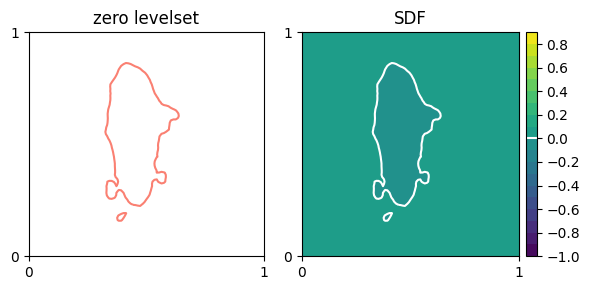

In [11]:
plot2d(lambda x: model(jnp.array([0.5, x[0], x[1]])), ngrid=100)

In [45]:
## TODO
# normals = data["gradient"]
# loss, model = fit(xs, ys, normals=normals, steps=100, cb_every=10, batch_size=1024, 
#                   emb_kwargs={'nmax': 8}, key=key)
# fig = plot3d(model, (-0.1, 1.1), ngrid=50)
# fig